In [2]:
using LinearAlgebra
using SparseArrays
using Plots

In [3]:
using Revise
using LatticeQM

# Tutorial: Magnetic fields

# Honeycomb lattice

Computing bands... 100%|████████████████████████████████| Time: 0:00:01


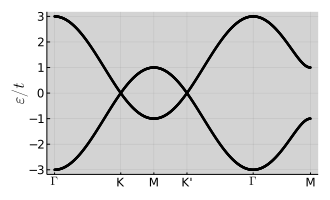

In [5]:
lat = Geometries2D.honeycomb()
ks = kpath(lat; num_points=800)

hops = Operators.graphene(lat; format=:dense, mode=:nospin, tz=0.3)
# hops = TightBinding.superlattice(hops, [1,4])
bands = getbands(hops, ks)

plot(bands; ylabel="\$\\varepsilon/t\$", size=(330,200))

## Graphene at flux $\phi=1/2$ (magnetic supercell)

Building magnetic supercell for Φ=p/q=1/2.

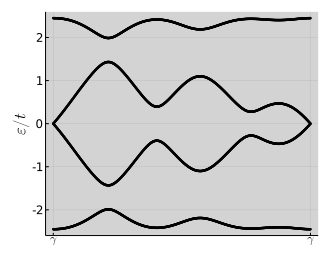

In [10]:
lat = Geometries2D.honeycomb()
hops = Operators.graphene(lat; mode=:nospin, tz=0.3)

mhops, mlat = Operators.peierlsoutplane(hops, lat, 1,2)

ks = kpath(mlat, ["γ", "γ1"]; num_points=800)
bands = getbands(mhops, ks)

plot(bands; ylabel="\$\\varepsilon/t\$", size=(330,260))

#### Hofstadter spectrum

In [6]:
lat = Geometries2D.honeycomb()
hops = Operators.graphene(lat; format=:dense, mode=:nospin, tz=0.2, ℓinter=0.01, ℓintra=0.001)
# Operators.addsublatticeimbalance!(hops, lat, 0.15)

fluxes, energies = Operators.hofstadter(hops, lat, 30);
nothing

Iterating through flux... 100%|█████████████████████████| Time: 0:00:05


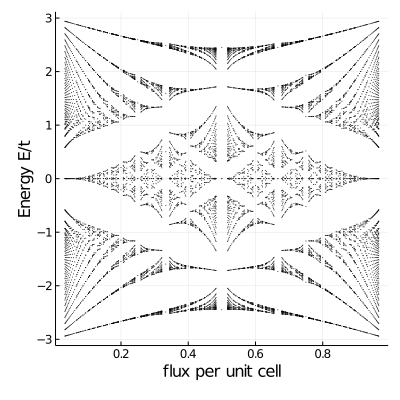

In [7]:
p = plot()
for (ϕ,Es)=zip(fluxes,energies)
    scatter!(p, repeat([ϕ],length(Es)), Es; markersize=0.75, markercolor=:black, legend=false)
end
plot!(p, xlabel="flux per unit cell", ylabel="Energy E/t")
plot!(p, size=(400,400))
p

In [8]:
lat = Geometries2D.honeycomb()
hops = Operators.graphene(lat; mode=:nospin, tz=0.3)

fluxes, energies, DOS = Operators.hofstadter_dos(hops, lat, 30, (-3.0,3.0); Γ=0.03)
nothing

Iterating through flux... 100%|█████████████████████████| Time: 0:02:13


In [11]:
using Statistics: quantile
data = hcat([[fluxes[j],energies[i],DOS[i,j]] for i=1:size(DOS,1) for j=1:size(DOS,2)]...)
max = quantile(abs.(DOS[:]), 0.99)
nothing

130.73434740126265

In [18]:
gr()

Plots.GRBackend()

In [12]:
p = scatter(data[1,:], data[2,:]; zcolor=data[3,:],legend=false,colorbar=true,colorbar_title="DOS [a.u.]",markersize=0.85,markerstrokewidth=0,c=cgrad(:afmhot, rev = true),clims=(0,max))
plot!(p, xlabel="flux per unit cell", ylabel="Energy E/t")
plot!(p, size=(400,300))
p


InterruptException: InterruptException:

# Square lattice

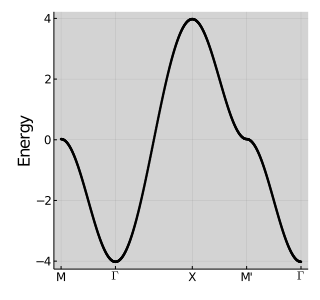

In [20]:
lat = Geometries2D.square()
hops = Operators.graphene(lat; mode=:nospin, tz=0.3)
ks = kpath(lat; num_points=800)
bands = getbands(hops, ks)
plot(bands)

In [21]:
lat = Geometries2D.square()
hops = Operators.graphene(lat; mode=:nospin, tz=0.3)

fluxes0, energies0 = Operators.hofstadter(hops, lat, 50);
nothing

Iterating through flux... 100%|█████████████████████████| Time: 0:00:03


In [22]:
p = plot()
for (ϕ,Es)=zip(fluxes0,energies0)
    scatter!(p, repeat([ϕ],length(Es)), Es; markersize=0.75, markercolor=:black, legend=false)
end
plot!(p, xlabel="flux per unit cell", ylabel="Energy E/t")
plot!(p, size=(400,300))
p

In [20]:
lat = Geometries2D.square()
hops = Operators.graphene(lat; mode=:nospin, tz=0.3)

fluxes, energies, DOS = Operators.hofstadter_dos(hops, lat, 30, (-4.0,4.0); Γ=0.03)
nothing

Iterating through flux... 100%|█████████████████████████| Time: 0:00:53


In [21]:
import Statistics: quantile
data = hcat([[fluxes[j],energies[i],DOS[i,j]] for i=1:size(DOS,1) for j=1:size(DOS,2)]...)

max = quantile(abs.(DOS[:]), 0.99)
p = scatter(data[1,:],data[2,:],zcolor=data[3,:],legend=false,colorbar=true,colorbar_title="DOS [a.u.]",markersize=0.85,markerstrokewidth=0,c=cgrad(:afmhot, rev = true),clims=x->(0,max))
plot!(p, xlabel="flux per unit cell", ylabel="Energy E/t")
plot!(p, size=(400,300))
p
